In [32]:
import pandas as pd
import numpy as np
np.random.seed(123)
# Matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib
matplotlib.rcParams['font.size'] = 8
matplotlib.rcParams['figure.figsize'] = (5, 5)
import seaborn as sns
from IPython.core.pylabtools import figsize
# Scipy helper functions
import scipy
from scipy.stats import percentileofscore
from scipy import stats

In [33]:
import pandas as pd
file_name = "student-mat.csv"
df_data = pd.read_csv(file_name, sep=',', index_col=None)

In [34]:
df_data.head(2).append(df_data.tail(2))

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,...,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,...,4,3,4,1,1,3,6,5,6,6
1,GP,F,17,U,GT3,T,1,1,at_home,other,...,5,3,3,1,1,3,4,5,5,6
393,MS,M,18,R,LE3,T,3,2,services,other,...,4,4,1,3,4,5,0,11,12,10
394,MS,M,19,U,LE3,T,1,1,other,at_home,...,3,2,3,3,3,5,5,8,9,9


In [36]:
df_data.shape

(395, 33)

In [38]:
df_data['Finalc']=df_data['Dalc']+df_data['Walc']
df_data.head()

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,...,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,Finalc
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,...,3,4,1,1,3,6,5,6,6,2
1,GP,F,17,U,GT3,T,1,1,at_home,other,...,3,3,1,1,3,4,5,5,6,2
2,GP,F,15,U,LE3,T,1,1,at_home,other,...,3,2,2,3,3,10,7,8,10,5
3,GP,F,15,U,GT3,T,4,2,health,services,...,2,2,1,1,5,2,15,14,15,2
4,GP,F,16,U,GT3,T,3,3,other,other,...,3,2,1,2,5,4,6,10,10,3


In [41]:
category_df = df_data.select_dtypes('object')
category_df

,school,sex,address,famsize,Pstatus,Mjob,Fjob,reason,guardian,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic
0,GP,F,U,GT3,A,at_home,teacher,course,mother,yes,no,no,no,yes,yes,no,no
1,GP,F,U,GT3,T,at_home,other,course,father,no,yes,no,no,no,yes,yes,no
2,GP,F,U,LE3,T,at_home,other,other,mother,yes,no,yes,no,yes,yes,yes,no
3,GP,F,U,GT3,T,health,services,home,mother,no,yes,yes,yes,yes,yes,yes,yes
4,GP,F,U,GT3,T,other,other,home,father,no,yes,yes,no,yes,yes,no,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,MS,M,U,LE3,A,services,services,course,other,no,yes,yes,no,yes,yes,no,no
391,MS,M,U,LE3,T,services,services,course,mother,no,no,no,no,no,yes,yes,no
392,MS,M,R,GT3,T,other,other,course,other,no,no,no,no,no,yes,no,no
393,MS,M,R,LE3,T,services,other,course,mother,no,no,no,no,no,yes,yes,no


In [6]:
dummy_df = pd.get_dummies(df_data.select_dtypes('object'))

In [7]:
dummy_df.head()

,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes
0,1,0,1,0,0,1,1,0,1,0,...,1,0,0,1,0,1,1,0,1,0
1,1,0,1,0,0,1,1,0,0,1,...,1,0,1,0,0,1,0,1,1,0
2,1,0,1,0,0,1,0,1,0,1,...,1,0,0,1,0,1,0,1,1,0
3,1,0,1,0,0,1,1,0,0,1,...,0,1,0,1,0,1,0,1,0,1
4,1,0,1,0,0,1,1,0,0,1,...,1,0,0,1,0,1,1,0,1,0


In [8]:
df1 = df_data.select_dtypes('number')
df1.head()

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,Finalc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,6,6,2
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,5,6,2
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,8,10,5
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,14,15,2
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10,10,3


In [9]:
result = pd.concat([dummy_df, df1], axis=1)

In [10]:
result.head()

,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,Finalc
0,1,0,1,0,0,1,1,0,1,0,...,3,4,1,1,3,6,5,6,6,2
1,1,0,1,0,0,1,1,0,0,1,...,3,3,1,1,3,4,5,5,6,2
2,1,0,1,0,0,1,0,1,0,1,...,3,2,2,3,3,10,7,8,10,5
3,1,0,1,0,0,1,1,0,0,1,...,2,2,1,1,5,2,15,14,15,2
4,1,0,1,0,0,1,1,0,0,1,...,3,2,1,2,5,4,6,10,10,3


In [24]:
result.shape()

TypeError: 'tuple' object is not callable

In [11]:
import csv
result.to_csv('result_mat.csv')

In [12]:
import pandas
import seaborn as sns
import numpy as np
import os
import matplotlib.pyplot as plt

In [13]:
df_num=df1
df_num.head()

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,Finalc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,6,6,2
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,5,6,2
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,8,10,5
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,14,15,2
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10,10,3


In [22]:
df_num.to_csv('numeric_mat.csv')

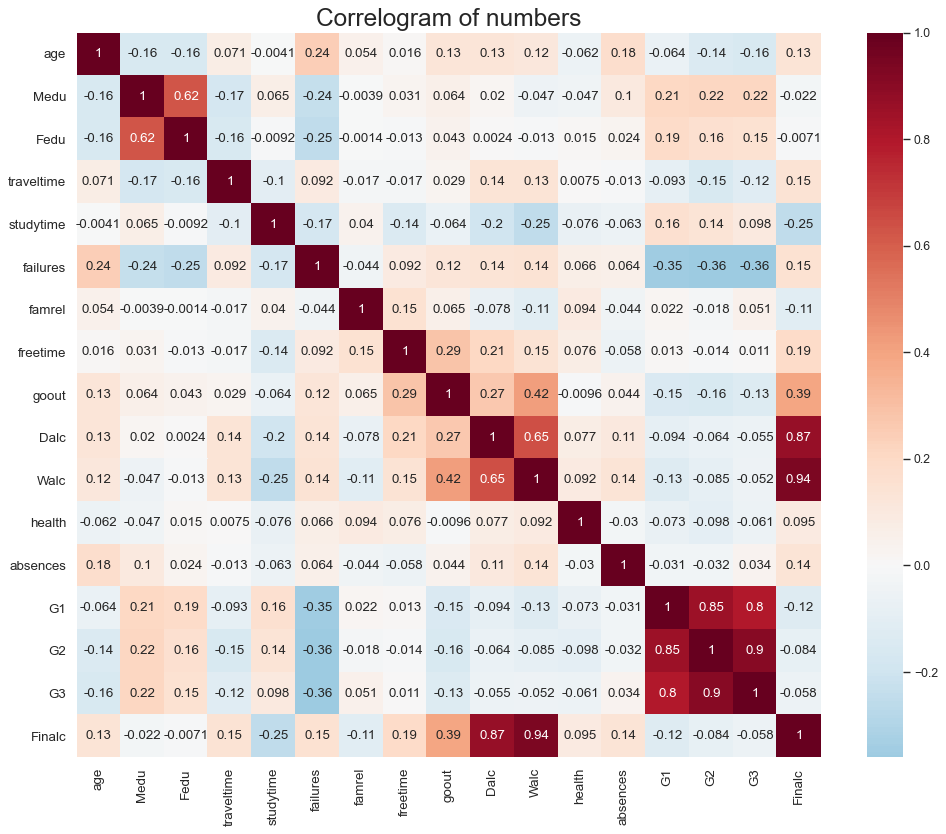

In [30]:
plt.figure(figsize=(15,12), dpi= 80)
sns.heatmap(df_num.corr(), 
            xticklabels=df_num.corr().columns, 
            yticklabels=df_num.corr().columns, 
            #cmap='RdYlGn', 
            cmap='RdBu_r',
            center=0, annot=True)

# Decorations
plt.title('Correlogram of numbers', fontsize=22)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

In [16]:
import seaborn as sns
%matplotlib inline
sns.set(font_scale=1.0)

In [17]:
df_ob=dummy_df
df_ob.head()

,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes
0,1,0,1,0,0,1,1,0,1,0,...,1,0,0,1,0,1,1,0,1,0
1,1,0,1,0,0,1,1,0,0,1,...,1,0,1,0,0,1,0,1,1,0
2,1,0,1,0,0,1,0,1,0,1,...,1,0,0,1,0,1,0,1,1,0
3,1,0,1,0,0,1,1,0,0,1,...,0,1,0,1,0,1,0,1,0,1
4,1,0,1,0,0,1,1,0,0,1,...,1,0,0,1,0,1,1,0,1,0


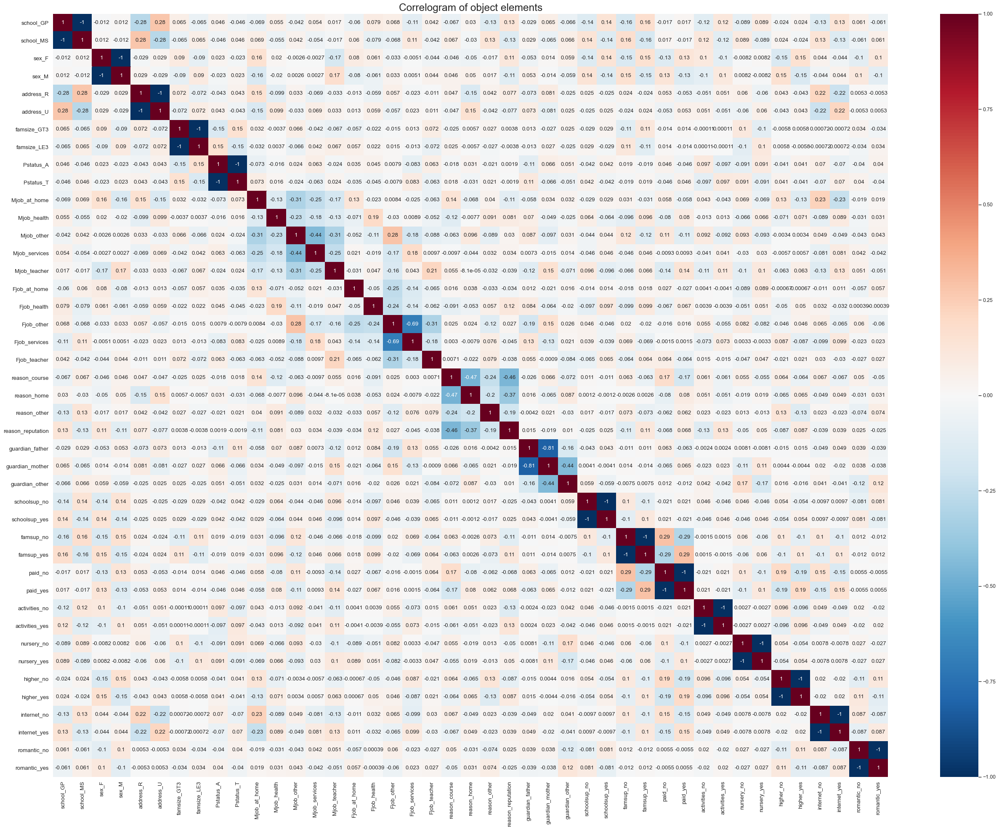

In [18]:
plt.figure(figsize=(40,30), dpi= 80)
sns.heatmap(df_ob.corr(), 
            xticklabels=df_ob.corr().columns, 
            yticklabels=df_ob.corr().columns, 
            cmap='RdBu_r', center=0,annot=True)

# Decorations
plt.title('Correlogram of object elements', fontsize=22)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

In [19]:
df=result
df.head()

,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,Finalc
0,1,0,1,0,0,1,1,0,1,0,...,3,4,1,1,3,6,5,6,6,2
1,1,0,1,0,0,1,1,0,0,1,...,3,3,1,1,3,4,5,5,6,2
2,1,0,1,0,0,1,0,1,0,1,...,3,2,2,3,3,10,7,8,10,5
3,1,0,1,0,0,1,1,0,0,1,...,2,2,1,1,5,2,15,14,15,2
4,1,0,1,0,0,1,1,0,0,1,...,3,2,1,2,5,4,6,10,10,3


In [23]:
df.to_csv('binary_mat.csv')

In [20]:
plt.figure(figsize=(60,40), dpi= 600)
sns.heatmap(df.corr(), xticklabels=df.corr().columns, yticklabels=df.corr().columns,
            linewidths=0.3,cmap='RdBu_r', center=0, annot=True)

# Decorations
plt.title('Correlation Matrix of Whole Elements', fontsize=22)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

In [21]:
df.corr()['Finalc'].sort_values()

sex_F               -0.298331
studytime           -0.252698
G1                  -0.124158
famsize_GT3         -0.112695
famrel              -0.108427
address_U           -0.107599
reason_reputation   -0.107207
nursery_yes         -0.102685
higher_yes          -0.096466
school_GP           -0.093508
Fjob_at_home        -0.089976
G2                  -0.083901
famsup_yes          -0.070435
paid_no             -0.067274
schoolsup_yes       -0.066207
Fjob_teacher        -0.060693
Fjob_health         -0.060631
G3                  -0.058245
activities_yes      -0.054177
internet_no         -0.023839
Medu                -0.021681
Mjob_health         -0.019371
guardian_mother     -0.018794
guardian_other      -0.012682
Pstatus_T           -0.009808
Mjob_at_home        -0.009163
Mjob_other          -0.007661
Fedu                -0.007127
Fjob_other          -0.001430
romantic_no         -0.000206
romantic_yes         0.000206
reason_course        0.008051
Pstatus_A            0.009808
Mjob_servi